# Прекод

# Сборный проект-4

Вам поручено разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — покажет, насколько текст и картинка подходят друг другу.

### Описание данных

Данные доступны по [ссылке](https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip).

В файле `train_dataset.csv` находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

1. Имя файла изображения.
2. Идентификатор описания.

3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

В файле `test_queries.csv` находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `test_images` содержатся изображения для тестирования модели.

## 1. Исследовательский анализ данных

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи вы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Вы можете воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Ваша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.


In [979]:
import torch.nn as nn
import torchvision.models as models

from torchsummary import summary

import numpy as np
import pandas as pd

import tensorflow as tf
from torchvision import transforms
import torch
import torch.nn as nn
import torchvision.models as models


from PIL import Image
import os

from tqdm import tqdm
from tqdm import notebook

import nltk
from nltk.corpus import stopwords as nltk_stopwords
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer

import re

from sklearn.model_selection import GroupShuffleSplit

import os
import matplotlib.pyplot as plt

In [969]:
from sklearn.pipeline import Pipeline

from sklearn.tree import DecisionTreeClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import GridSearchCV

from transformers import BertTokenizer, BertModel

import warnings

from sklearn.linear_model import LinearRegression
import catboost
from sklearn.metrics import mean_squared_error

In [791]:
CrowdAnnotations = pd.read_csv(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\CrowdAnnotations.tsv',sep='\t', 
                               header = None, names=['image', 'query_id', 'result', 'Yes', 'No'])
CrowdAnnotations['discribe'] = CrowdAnnotations['image'] + '_' + CrowdAnnotations['query_id'] 
CrowdAnnotations.head(20)

,image,query_id,result,Yes,No,discribe
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,3,0,1056338697_4f7d7ce270.jpg_1056338697_4f7d7ce27...
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_114051287_dd85625a04...
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_1427391496_ea512cbe7...
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2073964624_52da3a0fc...
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2083434441_a93bc6306...
5,1056338697_4f7d7ce270.jpg,2204550058_2707d92338.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2204550058_2707d9233...
6,1056338697_4f7d7ce270.jpg,2224450291_4c133fabe8.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2224450291_4c133fabe...
7,1056338697_4f7d7ce270.jpg,2248487950_c62d0c81a9.jpg#2,0.333333,1,2,1056338697_4f7d7ce270.jpg_2248487950_c62d0c81a...
8,1056338697_4f7d7ce270.jpg,2307118114_c258e3a47e.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2307118114_c258e3a47...
9,1056338697_4f7d7ce270.jpg,2309860995_c2e2a0feeb.jpg#2,0.000000,0,3,1056338697_4f7d7ce270.jpg_2309860995_c2e2a0fee...


In [792]:
CrowdAnnotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     47830 non-null  object 
 1   query_id  47830 non-null  object 
 2   result    47830 non-null  float64
 3   Yes       47830 non-null  int64  
 4   No        47830 non-null  int64  
 5   discribe  47830 non-null  object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.2+ MB


In [793]:
ExpertAnnotations = pd.read_csv(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\ExpertAnnotations.tsv',sep='\t', 
                               header = None, names=['image', 'query_id', 'Exp1', 'Exp2', 'Exp3'])
ExpertAnnotations['discribe'] = ExpertAnnotations['image'] + '_' + ExpertAnnotations['query_id'] 
ExpertAnnotations.head(20)

,image,query_id,Exp1,Exp2,Exp3,discribe
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,1056338697_4f7d7ce270.jpg_2549968784_39bfbe44f...
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1056338697_4f7d7ce270.jpg_2718495608_d8533e3ac...
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,1056338697_4f7d7ce270.jpg_3181701312_70a379ab6...
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,1056338697_4f7d7ce270.jpg_3207358897_bfa61fa3c...
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,1056338697_4f7d7ce270.jpg_3286822339_5535af6b9...
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1,1056338697_4f7d7ce270.jpg_3360930596_1e75164ce...
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1,1056338697_4f7d7ce270.jpg_3545652636_074653730...
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2,1056338697_4f7d7ce270.jpg_434792818_56375e203f...
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1,106490881_5a2dd9b7bd.jpg_1425069308_488e5fcf9d...
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2,106490881_5a2dd9b7bd.jpg_1714316707_8bbaa2a2ba...


In [794]:
ExpertAnnotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   Exp1      5822 non-null   int64 
 3   Exp2      5822 non-null   int64 
 4   Exp3      5822 non-null   int64 
 5   discribe  5822 non-null   object
dtypes: int64(3), object(3)
memory usage: 273.0+ KB


Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

Тогда переложим их градации в шкалу от 0 до 1, где
1 балл = 0
2 балла = 0,25
3 балла = 0,75
4 балла = 1

И определим средний балл в шкале от 0 до 1 от торех экспертов

In [796]:
def condition(x):
    if x==1:
        return 0
    elif x==2:
        return 0.25
    elif x==3:
        return 0.75
    else:
        return 1

ExpertAnnotations['Exp1'] = ExpertAnnotations['Exp1'].apply(condition)
ExpertAnnotations['Exp2'] = ExpertAnnotations['Exp2'].apply(condition)
ExpertAnnotations['Exp3'] = ExpertAnnotations['Exp3'].apply(condition)

In [797]:
ExpertAnnotations['result'] = (ExpertAnnotations['Exp1']+ExpertAnnotations['Exp2']+ExpertAnnotations['Exp3'])/3

In [798]:
ExpertAnnotations.head(10)

,image,query_id,Exp1,Exp2,Exp3,discribe,result
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,0.00,0.00,0.00,1056338697_4f7d7ce270.jpg_2549968784_39bfbe44f...,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,0.00,0.00,0.25,1056338697_4f7d7ce270.jpg_2718495608_d8533e3ac...,0.083333
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,0.00,0.00,0.25,1056338697_4f7d7ce270.jpg_3181701312_70a379ab6...,0.083333
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,0.00,0.25,0.25,1056338697_4f7d7ce270.jpg_3207358897_bfa61fa3c...,0.166667
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,0.00,0.00,0.25,1056338697_4f7d7ce270.jpg_3286822339_5535af6b9...,0.083333
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,0.00,0.00,0.00,1056338697_4f7d7ce270.jpg_3360930596_1e75164ce...,0.000000
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,0.00,0.00,0.00,1056338697_4f7d7ce270.jpg_3545652636_074653730...,0.000000
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,0.00,0.00,0.25,1056338697_4f7d7ce270.jpg_434792818_56375e203f...,0.083333
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,0.00,0.00,0.00,106490881_5a2dd9b7bd.jpg_1425069308_488e5fcf9d...,0.000000
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,0.25,0.25,0.25,106490881_5a2dd9b7bd.jpg_1714316707_8bbaa2a2ba...,0.250000


Соединяем экспертные и не экаспертный оценки и выводим итоговую

In [800]:
Annotations = pd.merge(CrowdAnnotations[['discribe','result']], ExpertAnnotations[['discribe','result']], on=['discribe'], how='left')

In [801]:
Annotations.head(20)

,discribe,result_x,result_y
0,1056338697_4f7d7ce270.jpg_1056338697_4f7d7ce27...,1.000000,NaN
1,1056338697_4f7d7ce270.jpg_114051287_dd85625a04...,0.000000,NaN
2,1056338697_4f7d7ce270.jpg_1427391496_ea512cbe7...,0.000000,NaN
3,1056338697_4f7d7ce270.jpg_2073964624_52da3a0fc...,0.000000,NaN
4,1056338697_4f7d7ce270.jpg_2083434441_a93bc6306...,0.000000,NaN
5,1056338697_4f7d7ce270.jpg_2204550058_2707d9233...,0.000000,NaN
6,1056338697_4f7d7ce270.jpg_2224450291_4c133fabe...,0.000000,NaN
7,1056338697_4f7d7ce270.jpg_2248487950_c62d0c81a...,0.333333,NaN
8,1056338697_4f7d7ce270.jpg_2307118114_c258e3a47...,0.000000,NaN
9,1056338697_4f7d7ce270.jpg_2309860995_c2e2a0fee...,0.000000,NaN


In [802]:
Annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   discribe  47830 non-null  object 
 1   result_x  47830 non-null  float64
 2   result_y  2329 non-null   float64
dtypes: float64(2), object(1)
memory usage: 1.1+ MB


In [803]:
Annotations.loc[Annotations['result_y'].isna(), ['result_y']] = Annotations['result_x']
Annotations.head(20)

,discribe,result_x,result_y
0,1056338697_4f7d7ce270.jpg_1056338697_4f7d7ce27...,1.000000,1.000000
1,1056338697_4f7d7ce270.jpg_114051287_dd85625a04...,0.000000,0.000000
2,1056338697_4f7d7ce270.jpg_1427391496_ea512cbe7...,0.000000,0.000000
3,1056338697_4f7d7ce270.jpg_2073964624_52da3a0fc...,0.000000,0.000000
4,1056338697_4f7d7ce270.jpg_2083434441_a93bc6306...,0.000000,0.000000
5,1056338697_4f7d7ce270.jpg_2204550058_2707d9233...,0.000000,0.000000
6,1056338697_4f7d7ce270.jpg_2224450291_4c133fabe...,0.000000,0.000000
7,1056338697_4f7d7ce270.jpg_2248487950_c62d0c81a...,0.333333,0.333333
8,1056338697_4f7d7ce270.jpg_2307118114_c258e3a47...,0.000000,0.000000
9,1056338697_4f7d7ce270.jpg_2309860995_c2e2a0fee...,0.000000,0.000000


In [804]:
Annotations['itog'] = Annotations['result_x'] * 0.4 + Annotations['result_y'] * 0.6
Annotations.head(20)

,discribe,result_x,result_y,itog
0,1056338697_4f7d7ce270.jpg_1056338697_4f7d7ce27...,1.000000,1.000000,1.000000
1,1056338697_4f7d7ce270.jpg_114051287_dd85625a04...,0.000000,0.000000,0.000000
2,1056338697_4f7d7ce270.jpg_1427391496_ea512cbe7...,0.000000,0.000000,0.000000
3,1056338697_4f7d7ce270.jpg_2073964624_52da3a0fc...,0.000000,0.000000,0.000000
4,1056338697_4f7d7ce270.jpg_2083434441_a93bc6306...,0.000000,0.000000,0.000000
5,1056338697_4f7d7ce270.jpg_2204550058_2707d9233...,0.000000,0.000000,0.000000
6,1056338697_4f7d7ce270.jpg_2224450291_4c133fabe...,0.000000,0.000000,0.000000
7,1056338697_4f7d7ce270.jpg_2248487950_c62d0c81a...,0.333333,0.333333,0.333333
8,1056338697_4f7d7ce270.jpg_2307118114_c258e3a47...,0.000000,0.000000,0.000000
9,1056338697_4f7d7ce270.jpg_2309860995_c2e2a0fee...,0.000000,0.000000,0.000000


In [805]:
Annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   discribe  47830 non-null  object 
 1   result_x  47830 non-null  float64
 2   result_y  47830 non-null  float64
 3   itog      47830 non-null  float64
dtypes: float64(3), object(1)
memory usage: 1.5+ MB


## 2. Проверка данных

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

Перечень слов исключений

In [808]:
exclude_words = [
'child',
'kid',
'baby',
'children',
'boy',
'girl',
'kids',
'babies',
'boys',
'girls'
]

In [809]:
train_dataset = pd.read_csv(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\train_dataset.csv')
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [810]:
train_dataset.head(10)

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [811]:
train_dataset = train_dataset.loc[~train_dataset['query_text'].str.contains('|'.join(exclude_words))].reset_index(drop = True)
train_dataset

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
1,3187395715_f2940c2b72.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
2,463978865_c87c6ca84c.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
3,488590040_35a3e96c89.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
4,534875358_6ea30d3091.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .
...,...,...,...
4329,799486353_f665d7b0f0.jpg,2170222061_e8bce4a32d.jpg#2,"A small animal leaps behind a larger animal , ..."
4330,799486353_f665d7b0f0.jpg,2196107384_361d73a170.jpg#2,a old man walks down the uncrowded road .
4331,909808296_23c427022d.jpg,2112921744_92bf706805.jpg#2,A dog stands on the side of a grassy cliff .
4332,929679367_ff8c7df2ee.jpg,3651971126_309e6a5e22.jpg#2,A blurry photo of two dogs .


In [812]:
train_dataset['discribe'] = train_dataset['image'] + '_' + train_dataset['query_id'] 
train_dataset

,image,query_id,query_text,discribe
0,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,1056338697_4f7d7ce270.jpg_3181701312_70a379ab6...
1,3187395715_f2940c2b72.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,3187395715_f2940c2b72.jpg_3181701312_70a379ab6...
2,463978865_c87c6ca84c.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,463978865_c87c6ca84c.jpg_3181701312_70a379ab6e...
3,488590040_35a3e96c89.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,488590040_35a3e96c89.jpg_3181701312_70a379ab6e...
4,534875358_6ea30d3091.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,534875358_6ea30d3091.jpg_3181701312_70a379ab6e...
...,...,...,...,...
4329,799486353_f665d7b0f0.jpg,2170222061_e8bce4a32d.jpg#2,"A small animal leaps behind a larger animal , ...",799486353_f665d7b0f0.jpg_2170222061_e8bce4a32d...
4330,799486353_f665d7b0f0.jpg,2196107384_361d73a170.jpg#2,a old man walks down the uncrowded road .,799486353_f665d7b0f0.jpg_2196107384_361d73a170...
4331,909808296_23c427022d.jpg,2112921744_92bf706805.jpg#2,A dog stands on the side of a grassy cliff .,909808296_23c427022d.jpg_2112921744_92bf706805...
4332,929679367_ff8c7df2ee.jpg,3651971126_309e6a5e22.jpg#2,A blurry photo of two dogs .,929679367_ff8c7df2ee.jpg_3651971126_309e6a5e22...


In [813]:
train_dataset = pd.merge(train_dataset, Annotations[['discribe','itog']], on=['discribe'], how='left')
train_dataset.head(20)

,image,query_id,query_text,discribe,itog
0,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,1056338697_4f7d7ce270.jpg_3181701312_70a379ab6...,NaN
1,3187395715_f2940c2b72.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,3187395715_f2940c2b72.jpg_3181701312_70a379ab6...,NaN
2,463978865_c87c6ca84c.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,463978865_c87c6ca84c.jpg_3181701312_70a379ab6e...,0.15
3,488590040_35a3e96c89.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,488590040_35a3e96c89.jpg_3181701312_70a379ab6e...,NaN
4,534875358_6ea30d3091.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,534875358_6ea30d3091.jpg_3181701312_70a379ab6e...,NaN
5,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,1056338697_4f7d7ce270.jpg_3207358897_bfa61fa3c...,NaN
6,3208074567_ac44aeb3f3.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,3208074567_ac44aeb3f3.jpg_3207358897_bfa61fa3c...,NaN
7,3251976937_20625dc2b8.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,3251976937_20625dc2b8.jpg_3207358897_bfa61fa3c...,NaN
8,370713359_7560808550.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,370713359_7560808550.jpg_3207358897_bfa61fa3c6...,0.00
9,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,1056338697_4f7d7ce270.jpg_3286822339_5535af6b9...,NaN


In [814]:
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4334 entries, 0 to 4333
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       4334 non-null   object 
 1   query_id    4334 non-null   object 
 2   query_text  4334 non-null   object 
 3   discribe    4334 non-null   object 
 4   itog        1818 non-null   float64
dtypes: float64(1), object(4)
memory usage: 169.4+ KB


In [815]:
train_dataset = train_dataset.dropna(subset=['itog'])

In [816]:
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1818 entries, 2 to 4332
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       1818 non-null   object 
 1   query_id    1818 non-null   object 
 2   query_text  1818 non-null   object 
 3   discribe    1818 non-null   object 
 4   itog        1818 non-null   float64
dtypes: float64(1), object(4)
memory usage: 85.2+ KB


### Тестовая выборка

In [818]:
test_dataset = pd.read_csv(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\test_queries.csv', sep='|')
test_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  500 non-null    int64 
 1   query_id    500 non-null    object
 2   query_text  500 non-null    object
 3   image       500 non-null    object
dtypes: int64(1), object(3)
memory usage: 15.8+ KB


In [819]:
test_dataset.head(10)

,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg
5,5,1232148178_4f45cc3284.jpg#0,A baby girl playing at a park .,1232148178_4f45cc3284.jpg
6,6,1232148178_4f45cc3284.jpg#1,A closeup of a child on a playground with adul...,1232148178_4f45cc3284.jpg
7,7,1232148178_4f45cc3284.jpg#2,A young boy poses for a picture in front of a ...,1232148178_4f45cc3284.jpg
8,8,1232148178_4f45cc3284.jpg#3,A young girl is smiling in front of the camera...,1232148178_4f45cc3284.jpg
9,9,1232148178_4f45cc3284.jpg#4,There is a little blond hair girl with a green...,1232148178_4f45cc3284.jpg


In [820]:
test_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  500 non-null    int64 
 1   query_id    500 non-null    object
 2   query_text  500 non-null    object
 3   image       500 non-null    object
dtypes: int64(1), object(3)
memory usage: 15.8+ KB


## 3. Векторизация изображений

Перейдём к векторизации изображений.

Самый примитивный способ — прочесть изображение и превратить полученную матрицу в вектор. Такой способ нам не подходит: длина векторов может быть сильно разной, так как размеры изображений разные. Поэтому стоит обратиться к свёрточным сетям: они позволяют "выделить" главные компоненты изображений. Как это сделать? Нужно выбрать какую-либо архитектуру, например ResNet-18, посмотреть на слои и исключить полносвязные слои, которые отвечают за конечное предсказание. При этом можно загрузить модель данной архитектуры, предварительно натренированную на датасете ImageNet.

In [822]:
#resnet = models.resnet18(pretrained=True)

#summary(resnet, input_size=(3, 224, 224))
#modules = list(resnet.children())[:-1]
#resnet = nn.Sequential(*modules) 

#resnet.eval() 

In [1106]:
resnet = models.resnet18(pretrained=True)

for param in resnet.parameters():
    param.requires_grad_(False) 
    
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules) 

resnet.eval()  

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [1108]:
norm = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    norm,
]) 

In [1110]:
img = Image.open(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\train_images\1056338697_4f7d7ce270.jpg').convert('RGB') 

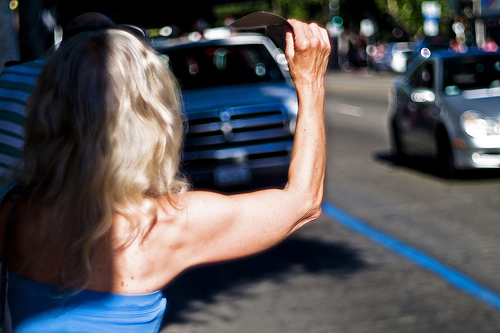

In [1112]:
img

In [1114]:
image_tensor = preprocess(img)
output_tensor = resnet(image_tensor.unsqueeze(0)).flatten()
output_tensor = pd.Series(output_tensor)
#output_tensor.size()
output_tensor

0      0.693981
1      3.031816
2      2.916986
3      0.951921
4      0.936226
         ...   
507    0.750846
508    1.196695
509    0.085011
510    1.056858
511    0.098236
Length: 512, dtype: float32

In [1116]:
image_tensor = preprocess(img)
image_tensor

tensor([[[-1.7583, -1.7925, -1.8097,  ..., -1.9295, -1.8782, -1.6727],
         [-1.9467, -1.9467, -1.9124,  ..., -1.9467, -1.9124, -1.8097],
         [-2.0323, -2.0837, -2.0323,  ..., -1.9980, -1.9295, -1.8439],
         ...,
         [-1.8439, -1.8268, -1.8268,  ..., -0.5767, -0.6109, -0.6109],
         [-1.6555, -1.6042, -1.6042,  ..., -0.5938, -0.5767, -0.5767],
         [-1.0048, -0.9020, -0.9020,  ..., -0.6281, -0.5938, -0.6109]],

        [[-1.6331, -1.6155, -1.5805,  ..., -1.7206, -1.6856, -1.4930],
         [-1.7906, -1.7731, -1.7031,  ..., -1.7556, -1.7381, -1.6506],
         [-1.8431, -1.8782, -1.8431,  ..., -1.7906, -1.7381, -1.6856],
         ...,
         [ 0.2577,  0.2752,  0.2577,  ..., -0.5301, -0.5126, -0.5126],
         [ 0.3978,  0.3803,  0.3978,  ..., -0.5301, -0.4776, -0.4776],
         [ 0.7129,  0.7304,  0.7479,  ..., -0.5476, -0.4951, -0.4951]],

        [[-1.1421, -1.0898, -0.9678,  ..., -1.4210, -1.3687, -1.2816],
         [-1.3164, -1.3339, -1.2467,  ..., -1

In [1118]:
output_tensor = resnet(image_tensor.unsqueeze(0)).flatten() 
output_tensor

tensor([6.9398e-01, 3.0318e+00, 2.9170e+00, 9.5192e-01, 9.3623e-01, 1.2452e+00,
        8.2655e-01, 1.1081e+00, 1.6970e-01, 3.6528e-01, 2.5528e-01, 1.4860e+00,
        3.0729e-01, 1.2506e+00, 4.2892e-02, 8.0657e-01, 9.3059e-01, 6.9563e-01,
        2.5997e-01, 1.6920e+00, 3.3072e-01, 8.2502e-01, 2.2856e+00, 1.9399e+00,
        1.1210e+00, 7.3168e-01, 1.3495e+00, 4.5218e-01, 3.2119e-01, 5.5150e-01,
        2.1655e+00, 2.2817e-01, 7.9772e-01, 1.5145e+00, 1.0656e+00, 9.0097e-01,
        5.6139e-01, 1.0667e+00, 2.3451e-01, 1.1880e+00, 8.0993e-01, 1.1380e+00,
        1.2139e+00, 1.0140e+00, 4.5742e-01, 8.2430e-01, 6.5279e-01, 4.4504e-03,
        7.6136e-01, 3.0094e+00, 3.7051e-01, 1.2697e-01, 6.4864e-01, 1.3021e-01,
        4.8987e-01, 2.8697e-01, 3.4986e-01, 1.4781e+00, 1.4834e+00, 8.1563e-01,
        1.8637e+00, 1.4660e+00, 1.3919e+00, 9.4174e-01, 7.5180e-01, 2.3145e-01,
        1.4664e-01, 5.0503e-01, 1.9546e-01, 1.2661e+00, 1.3835e+00, 6.5570e-01,
        2.1739e-01, 1.3539e-01, 7.6930e-

In [1120]:
output_tensor_train = []

for i in tqdm(train_dataset['image']):   
    img = Image.open(r"C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\train_images" + "\\" +i).convert('RGB') 
    image_tensor = preprocess(img)
    output_tensor_train.append(resnet(image_tensor.unsqueeze(0)).flatten().detach().numpy())

100%|██████████████████████████████████████████████████████████████████████████████| 1818/1818 [00:39<00:00, 45.49it/s]


In [1121]:
output_tensor_train[0]

array([9.80667353e-01, 3.82916379e+00, 1.29661715e+00, 8.03800404e-01,
       5.16710341e-01, 4.09085125e-01, 7.24090755e-01, 8.38845491e-01,
       2.44295076e-01, 3.96823347e-01, 4.95951563e-01, 5.38948894e-01,
       6.38508737e-01, 1.08697951e-01, 6.90226674e-01, 1.10917139e+00,
       1.88386679e+00, 2.66932622e-02, 3.09657753e-01, 6.34006321e-01,
       2.36900091e-01, 8.39071572e-01, 1.61364448e+00, 1.23762727e+00,
       1.03665030e+00, 1.68113515e-01, 5.49437761e-01, 4.91772830e-01,
       6.69102311e-01, 8.62774193e-01, 6.45282209e-01, 5.05465083e-02,
       5.13802409e-01, 4.63276282e-02, 6.28594697e-01, 4.48069990e-01,
       2.46209204e-01, 5.07217050e-01, 1.74439743e-01, 2.17781559e-01,
       2.20088959e-01, 2.55564213e-01, 4.97584581e-01, 1.58913028e+00,
       1.09315979e+00, 4.41766143e-01, 3.78785968e-01, 1.05160230e-04,
       4.58031356e-01, 3.50310624e-01, 1.34218678e-01, 4.67659742e-01,
       4.77375537e-01, 1.11257696e+00, 8.83976996e-01, 3.96137238e-01,
      

## 4. Векторизация текстов

Следующий этап — векторизация текстов. Вы можете поэкспериментировать с несколькими способами векторизации текстов:

- tf-idf
- word2vec
- \*трансформеры (например Bert)

\* — если вы изучали трансформеры в спринте Машинное обучение для текстов.


#### Стандартный подход

In [1124]:
m = WordNetLemmatizer() 

In [1125]:
nltk.download('stopwords')
stopwords = list(set(nltk_stopwords.words('english')))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Igor\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [1126]:
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

In [1127]:
def text_tokenize(text):
    #tokenized = nltk.word_tokenize(text)
    tokenized =  [m.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(text)]
    joined = ' '.join(tokenized)
    text = re.sub(r'[^a-zA-Z]', ' ', joined)
    text = ' '.join(text.split())
    #text =  [m.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(text)]
    return text

In [1128]:
train_dataset=train_dataset.reset_index(drop=True)

In [1129]:
txt = text_tokenize(train_dataset['query_text'][0])
txt

'A man sleep under a blanket on a city street'

In [1130]:
notebook.tqdm.pandas() 
train_dataset['text_final'] = train_dataset['query_text'].progress_apply(text_tokenize)

  0%|          | 0/1818 [00:00<?, ?it/s]

In [1131]:
train_dataset

,image,query_id,query_text,discribe,itog,text_final
0,463978865_c87c6ca84c.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,463978865_c87c6ca84c.jpg_3181701312_70a379ab6e...,0.15,A man sleep under a blanket on a city street
1,370713359_7560808550.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,370713359_7560808550.jpg_3207358897_bfa61fa3c6...,0.00,A woman play with long red ribbon in an empty ...
2,1962729184_6996e128e7.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,1962729184_6996e128e7.jpg_3286822339_5535af6b9...,0.20,Chinese market street in the winter time
3,2101457132_69c950bc45.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,2101457132_69c950bc45.jpg_3286822339_5535af6b9...,0.00,Chinese market street in the winter time
4,2351479551_e8820a1ff3.jpg,3360930596_1e75164ce6.jpg#2,A soccer ball is above the head of a man weari...,2351479551_e8820a1ff3.jpg_3360930596_1e75164ce...,0.05,A soccer ball be above the head of a man wear ...
...,...,...,...,...,...,...
1813,415793623_6c1225ae27.jpg,2554081584_233bdf289a.jpg#2,a man wearing a yellow shirt and white hardhat...,415793623_6c1225ae27.jpg_2554081584_233bdf289a...,0.10,a man wear a yellow shirt and white hardhat st...
1814,476759700_8911f087f8.jpg,1082379191_ec1e53f996.jpg#2,A man and a woman sitting on a dock .,476759700_8911f087f8.jpg_1082379191_ec1e53f996...,0.05,A man and a woman sit on a dock
1815,561417861_8e25d0c0e8.jpg,410453140_5401bf659a.jpg#2,A man stands at the entrance of Yerba Buena Ce...,561417861_8e25d0c0e8.jpg_410453140_5401bf659a....,0.15,A man stand at the entrance of Yerba Buena Cen...
1816,561940436_64d6fc125d.jpg,3157847991_463e006a28.jpg#2,Two men in black jackets behind a white handra...,561940436_64d6fc125d.jpg_3157847991_463e006a28...,0.05,Two men in black jacket behind a white handrail


In [1132]:
#Подгрузка векторизация
count_tf_idf = TfidfVectorizer(stop_words=stopwords)
tf_idf = count_tf_idf.fit_transform(train_dataset['text_final'])

In [1133]:
x= tf_idf.toarray()
x[0]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.59492148, 0.        , 0.     

#### Bert

In [1135]:
bert_model = BertModel.from_pretrained('bert-base-uncased',
                                       output_hidden_states=True)
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [1136]:
def transform_text(column):
    tokenized = column.apply(lambda x: tokenizer.encode(x, add_special_tokens=True))

    max_len = 0
    for i in tokenized.values:
        if len(i) > max_len:
            max_len = len(i)

    padded = np.array([i + [0]*(max_len - len(i)) for i in tokenized.values])
    attention_mask = np.where(padded != 0, 1, 0)
    
    batch_size = 100
    embeddings = []
    batch_count = padded.shape[0] // batch_size + 1
    for i in tqdm(range(batch_count), disable=batch_count==1):
        batch = torch.LongTensor(padded[batch_size*i:batch_size*(i+1)]) 
        attention_mask_batch = torch.LongTensor(attention_mask[batch_size*i:batch_size*(i+1)])
        with torch.no_grad():
            batch_embeddings = bert_model(batch, attention_mask=attention_mask_batch)
        
        embeddings.append(batch_embeddings[0][:,0,:].numpy())
    return np.concatenate(embeddings)

In [1137]:
text_features = transform_text(train_dataset['query_text'])
text_features.shape

100%|██████████████████████████████████████████████████████████████████████████████████| 19/19 [00:30<00:00,  1.59s/it]


(1818, 768)

In [1138]:
text_features

array([[ 0.22594558, -0.14776984, -0.4104268 , ..., -0.31920686,
         0.4300089 ,  0.24305476],
       [ 0.36371875,  0.16300896, -0.4905536 , ..., -0.30124572,
         0.14865443,  0.3463128 ],
       [-0.36842403, -0.2357744 , -0.30580106, ..., -0.53511673,
         0.49860474,  0.07659642],
       ...,
       [ 0.1626457 , -0.15903017, -0.04936949, ..., -0.11595961,
         0.31280732,  0.29151744],
       [-0.05279898, -0.10772611, -0.85762554, ...,  0.23672184,
         0.37439084,  0.10391158],
       [-0.5235602 , -0.2747079 , -0.8157735 , ..., -0.14736916,
         0.11889757,  0.06756762]], dtype=float32)

## 5. Объединение векторов

In [1141]:
output_tensor_train

[array([9.80667353e-01, 3.82916379e+00, 1.29661715e+00, 8.03800404e-01,
        5.16710341e-01, 4.09085125e-01, 7.24090755e-01, 8.38845491e-01,
        2.44295076e-01, 3.96823347e-01, 4.95951563e-01, 5.38948894e-01,
        6.38508737e-01, 1.08697951e-01, 6.90226674e-01, 1.10917139e+00,
        1.88386679e+00, 2.66932622e-02, 3.09657753e-01, 6.34006321e-01,
        2.36900091e-01, 8.39071572e-01, 1.61364448e+00, 1.23762727e+00,
        1.03665030e+00, 1.68113515e-01, 5.49437761e-01, 4.91772830e-01,
        6.69102311e-01, 8.62774193e-01, 6.45282209e-01, 5.05465083e-02,
        5.13802409e-01, 4.63276282e-02, 6.28594697e-01, 4.48069990e-01,
        2.46209204e-01, 5.07217050e-01, 1.74439743e-01, 2.17781559e-01,
        2.20088959e-01, 2.55564213e-01, 4.97584581e-01, 1.58913028e+00,
        1.09315979e+00, 4.41766143e-01, 3.78785968e-01, 1.05160230e-04,
        4.58031356e-01, 3.50310624e-01, 1.34218678e-01, 4.67659742e-01,
        4.77375537e-01, 1.11257696e+00, 8.83976996e-01, 3.961372

In [1142]:
output_tensor_train = np.vstack(output_tensor_train)
output_tensor_train

array([[0.98066735, 3.8291638 , 1.2966172 , ..., 0.5092452 , 0.91190463,
        0.5583372 ],
       [1.667338  , 2.2940183 , 3.6151326 , ..., 2.109544  , 1.199736  ,
        1.0068048 ],
       [0.96387374, 1.2239447 , 1.547668  , ..., 1.4573574 , 1.7423767 ,
        0.15250728],
       ...,
       [0.7247397 , 1.3402551 , 1.6595817 , ..., 0.12944487, 1.0566951 ,
        0.25134635],
       [0.26965785, 1.5168393 , 0.87488216, ..., 2.8847044 , 1.0229987 ,
        0.7129414 ],
       [0.3790386 , 1.0550802 , 0.42936367, ..., 0.7615975 , 1.084765  ,
        0.18721661]], dtype=float32)

In [1143]:
tf_idf.toarray()

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.43304256, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [1144]:
output_tensor_train.shape

(1818, 512)

In [1145]:
tf_idf.toarray().shape

(1818, 810)

In [1146]:
train_uni = np.hstack([output_tensor_train, text_features])
train_uni

array([[ 0.98066735,  3.8291638 ,  1.2966172 , ..., -0.31920686,
         0.4300089 ,  0.24305476],
       [ 1.667338  ,  2.2940183 ,  3.6151326 , ..., -0.30124572,
         0.14865443,  0.3463128 ],
       [ 0.96387374,  1.2239447 ,  1.547668  , ..., -0.53511673,
         0.49860474,  0.07659642],
       ...,
       [ 0.7247397 ,  1.3402551 ,  1.6595817 , ..., -0.11595961,
         0.31280732,  0.29151744],
       [ 0.26965785,  1.5168393 ,  0.87488216, ...,  0.23672184,
         0.37439084,  0.10391158],
       [ 0.3790386 ,  1.0550802 ,  0.42936367, ..., -0.14736916,
         0.11889757,  0.06756762]], dtype=float32)

In [1147]:
train_uni.shape

(1818, 1280)

In [1148]:
train_uni_2 = np.hstack([output_tensor_train, text_features])
train_uni_2

array([[ 0.98066735,  3.8291638 ,  1.2966172 , ..., -0.31920686,
         0.4300089 ,  0.24305476],
       [ 1.667338  ,  2.2940183 ,  3.6151326 , ..., -0.30124572,
         0.14865443,  0.3463128 ],
       [ 0.96387374,  1.2239447 ,  1.547668  , ..., -0.53511673,
         0.49860474,  0.07659642],
       ...,
       [ 0.7247397 ,  1.3402551 ,  1.6595817 , ..., -0.11595961,
         0.31280732,  0.29151744],
       [ 0.26965785,  1.5168393 ,  0.87488216, ...,  0.23672184,
         0.37439084,  0.10391158],
       [ 0.3790386 ,  1.0550802 ,  0.42936367, ..., -0.14736916,
         0.11889757,  0.06756762]], dtype=float32)

In [1149]:
train_uni_2.shape

(1818, 1280)

In [1150]:
train_uni_2[0]

array([ 0.98066735,  3.8291638 ,  1.2966172 , ..., -0.31920686,
        0.4300089 ,  0.24305476], dtype=float32)

## 6. Обучение модели предсказания соответствия

In [1178]:
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)

In [1180]:
train_indices, test_indices = next(gss.split(X=train_uni_2, y=train_dataset['itog'], groups=train_dataset['image']))

In [1182]:
train_indices

array([   0,    1,    3, ..., 1814, 1815, 1816], dtype=int64)

In [1184]:
X_train = train_uni_2[train_indices]
X_test = train_uni_2[test_indices]
y_train = train_dataset['itog'].loc[train_indices]
y_test = train_dataset['itog'].loc[test_indices]

In [1186]:
X_train.shape

(1263, 1280)

In [1188]:
X_train[0]

array([ 0.98066735,  3.8291638 ,  1.2966172 , ..., -0.31920686,
        0.4300089 ,  0.24305476], dtype=float32)

In [1190]:
y_train

0       0.15
1       0.00
3       0.00
4       0.05
5       0.05
        ... 
1812    0.10
1813    0.10
1814    0.05
1815    0.15
1816    0.05
Name: itog, Length: 1263, dtype: float64

### Строим модель

#### Линейная регрессия

In [1194]:
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

LinearRegression()

In [1196]:
prediction = lr_model.predict(X_test)

In [1198]:
rmse = mean_squared_error(y_test, prediction) ** 0.5
rmse

2.4122133655447437

#### CatBoost

In [1201]:
train_pool = catboost.Pool(X_train, y_train)
val_pool = catboost.Pool(X_test, y_test)
cb_model = catboost.CatBoostRegressor(eval_metric='RMSE', verbose=100, random_seed=42)
cb_model.fit(train_pool, eval_set=val_pool, early_stopping_rounds=150)

Learning rate set to 0.052822
0:	learn: 0.3205508	test: 0.3209525	best: 0.3209525 (0)	total: 72.8ms	remaining: 1m 12s
100:	learn: 0.2271645	test: 0.2966030	best: 0.2965772 (95)	total: 6.78s	remaining: 1m
200:	learn: 0.1693065	test: 0.2930226	best: 0.2929729 (199)	total: 13.5s	remaining: 53.7s
300:	learn: 0.1238461	test: 0.2915887	best: 0.2909995 (273)	total: 20.4s	remaining: 47.3s
400:	learn: 0.0941958	test: 0.2892962	best: 0.2891529 (397)	total: 27s	remaining: 40.4s
500:	learn: 0.0717726	test: 0.2887794	best: 0.2886771 (479)	total: 33.7s	remaining: 33.6s
600:	learn: 0.0538115	test: 0.2885312	best: 0.2884496 (583)	total: 40.4s	remaining: 26.8s
700:	learn: 0.0414549	test: 0.2884636	best: 0.2883489 (622)	total: 47.1s	remaining: 20.1s
800:	learn: 0.0331740	test: 0.2881457	best: 0.2881457 (800)	total: 53.8s	remaining: 13.4s
900:	learn: 0.0259982	test: 0.2880436	best: 0.2880365 (898)	total: 1m	remaining: 6.66s
999:	learn: 0.0206275	test: 0.2879913	best: 0.2879559 (930)	total: 1m 7s	remainin

## 7. Тестирование модели

In [1202]:
#test_dataset = test_dataset['image'].drop_duplicates()
len(test_dataset)

100

In [1205]:
test_dataset = test_dataset.reset_index(drop = True)
test_dataset

0     1177994172_10d143cb8d.jpg
1     1232148178_4f45cc3284.jpg
2      123997871_6a9ca987b1.jpg
3     1319634306_816f21677f.jpg
4     1429546659_44cb09cbe2.jpg
                ...            
95     862177617_c2c0581075.jpg
96     957682378_46c3b07bcd.jpg
97     973827791_467d83986e.jpg
98     989754491_7e53fb4586.jpg
99     989851184_9ef368e520.jpg
Name: image, Length: 100, dtype: object

In [1207]:
test_queries = pd.read_csv(r'C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\test_queries.csv', sep='|', index_col=[0])
test_queries

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg
...,...,...,...
495,989851184_9ef368e520.jpg#0,A black dog has a dumbbell in his mouth .,989851184_9ef368e520.jpg
496,989851184_9ef368e520.jpg#1,A black dog has a dumbbell in his mouth lookin...,989851184_9ef368e520.jpg
497,989851184_9ef368e520.jpg#2,A black dog holding a weight in its mouth stan...,989851184_9ef368e520.jpg
498,989851184_9ef368e520.jpg#3,A black dog holds a small white dumbbell in it...,989851184_9ef368e520.jpg


In [1209]:
preview_df = test_queries.sample(20, random_state=42)
preview_df = preview_df.reset_index(drop = True)
preview_df

,query_id,query_text,image
0,3482859574_3908de3427.jpg#1,A group of girls who are gothically dressed st...,3482859574_3908de3427.jpg
1,2141713971_e25eb12712.jpg#3,A woman and girl riding downhill on a sled wit...,2141713971_e25eb12712.jpg
2,3488087117_2719647989.jpg#4,The dog is running .,3488087117_2719647989.jpg
3,269650644_059a84ece5.jpg#0,A group of people are ice skating in a big city .,269650644_059a84ece5.jpg
4,2428094795_d3a8f46046.jpg#4,Little kid in blue coat and hat riding a tricy...,2428094795_d3a8f46046.jpg
5,3553476195_fb3747d7c1.jpg#4,Two black dogs fighting over an orange toy .,3553476195_fb3747d7c1.jpg
6,3514297698_0512623955.jpg#2,A dog jumping for a tennis ball near an ocean,3514297698_0512623955.jpg
7,2505056124_1276e8dbcb.jpg#4,Boy flying a distant kite .,2505056124_1276e8dbcb.jpg
8,2121140070_a09644550b.jpg#3,kids play ultimate Frisbee .,2121140070_a09644550b.jpg
9,607339469_af851c4119.jpg#0,A girl in a purple shirt feeding ducks,607339469_af851c4119.jpg


Суть:
- векторизируем текст 1-ого запроса (TXT_1)
- векторизируем каждое тестовое изображение (IMG_i)
- соединияем два вектора (TXT_1 + IMG_1; TXT_1 + IMG_2...)
- получаем предсказательную метрику для каждого соединения
- вычисляем максимальную предсказательную метрику, исходя из чего определяем IMG_?  

#### Векторизируем тестовые изображения

In [1214]:
output_tensor_test = []

for i in tqdm(test_dataset):   
    img = Image.open(r"C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\test_images" + "\\" +i).convert('RGB') 
    image_tensor = preprocess(img)
    output_tensor_test.append(resnet(image_tensor.unsqueeze(0)).flatten().detach().numpy())

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:02<00:00, 41.49it/s]


In [1216]:
output_tensor_test

[array([4.43963259e-01, 2.33448601e+00, 6.33893674e-03, 2.39435291e+00,
        2.25137547e-02, 3.29740405e-01, 1.68388665e+00, 1.90014040e+00,
        2.15906411e-01, 3.34996507e-02, 1.86174065e-01, 1.29088616e+00,
        2.25852057e-01, 3.69095616e-02, 1.56545743e-01, 9.58963752e-01,
        1.37442899e+00, 3.06259245e-02, 4.74916995e-01, 1.10153186e+00,
        3.64688963e-01, 1.07780367e-01, 1.59478521e+00, 2.09151483e+00,
        2.22691798e+00, 4.25762869e-02, 3.02312598e-02, 1.04547024e+00,
        3.33624333e-02, 4.45628524e-01, 8.79042268e-01, 3.70483488e-01,
        1.77755393e-02, 1.24402337e-01, 8.03289533e-01, 7.35915661e-01,
        2.51176625e-01, 7.18735993e-01, 1.31592274e+00, 1.44869760e-01,
        1.89321414e-01, 3.17652941e-01, 7.30825722e-01, 4.47157919e-02,
        2.32051253e+00, 4.74335462e-01, 4.17341948e-01, 7.21339226e-01,
        4.99782264e-01, 3.92841339e-01, 2.07053393e-01, 4.35888171e-01,
        1.41327965e+00, 6.91690505e-01, 9.21289027e-02, 2.994727

In [1218]:
output_tensor_test = np.vstack(output_tensor_test)

In [1220]:
output_tensor_test.shape

(100, 512)

In [1222]:
output_tensor_test

array([[0.44396326, 2.334486  , 0.00633894, ..., 2.2927172 , 0.7935855 ,
        0.8501067 ],
       [0.8384453 , 1.5685871 , 1.8867319 , ..., 1.53422   , 1.347147  ,
        0.40417302],
       [0.44376585, 0.82659584, 1.7539892 , ..., 1.6676579 , 1.0231025 ,
        1.039767  ],
       ...,
       [1.3152146 , 0.27908653, 0.03596727, ..., 1.1838957 , 1.9113907 ,
        0.9813142 ],
       [0.44723582, 0.7011737 , 1.4683157 , ..., 0.36685628, 1.1089067 ,
        0.70710963],
       [0.90167177, 0.38705173, 1.5650169 , ..., 0.04256481, 2.6127827 ,
        0.23803365]], dtype=float32)

#### Векторизируем отобранные запросы

In [1225]:
tf_idf_test = transform_text(preview_df['query_text'])

In [1227]:
tf_idf_test

array([[ 0.07463922,  0.23512414, -0.20458636, ..., -0.40420076,
         0.15902701, -0.07300846],
       [-0.15022828,  0.22007027, -0.85021716, ..., -0.09338277,
         0.55141306, -0.26846293],
       [-0.22650944,  0.44317546, -0.1277436 , ..., -0.30966687,
         0.18338346,  0.33834463],
       ...,
       [-0.04972813,  0.26829687, -0.35402283, ..., -0.15473628,
         0.44778135,  0.629303  ],
       [ 0.16687717,  0.39645165, -0.1948474 , ..., -0.592013  ,
         0.07256776,  0.2358573 ],
       [ 0.23413315,  0.2311458 , -0.18029882, ..., -0.23062341,
         0.35536575,  0.6218539 ]], dtype=float32)

In [1229]:
tf_idf_test.shape

(20, 768)

In [940]:
tf_idf_test = count_tf_idf.transform(preview_df['query_text'])
tf_idf_test

<20x810 sparse matrix of type '<class 'numpy.float64'>'
	with 78 stored elements in Compressed Sparse Row format>

In [942]:
tf_idf_test = tf_idf_test.toarray()

In [944]:
tf_idf_test.shape

(20, 810)

Мера близости: 0.6487
A group of girls who are gothically dressed standing together


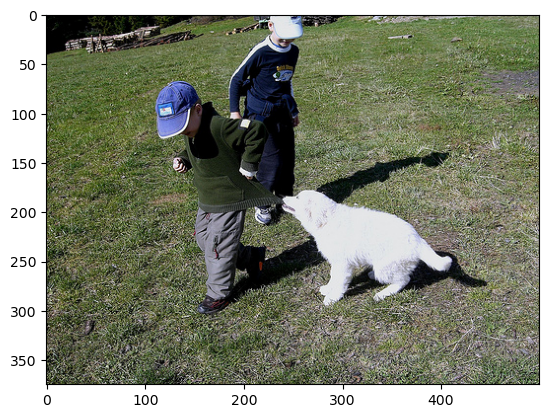

Мера близости: 0.5547
A woman and girl riding downhill on a sled with a dog running alongside them


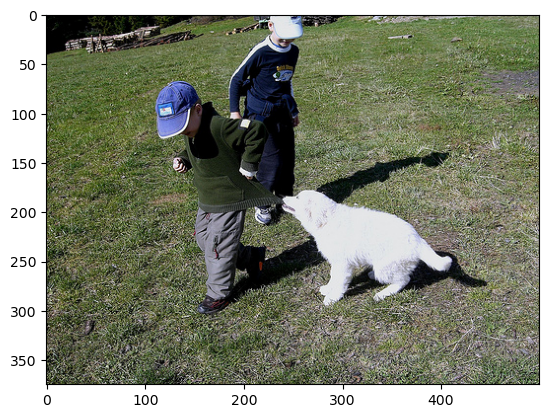

Мера близости: 0.5483
The dog is running .


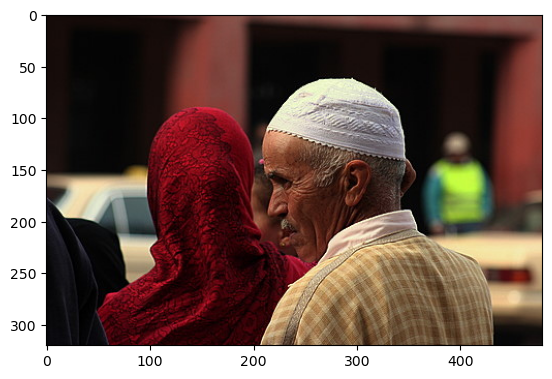

Мера близости: 0.5566
A group of people are ice skating in a big city .


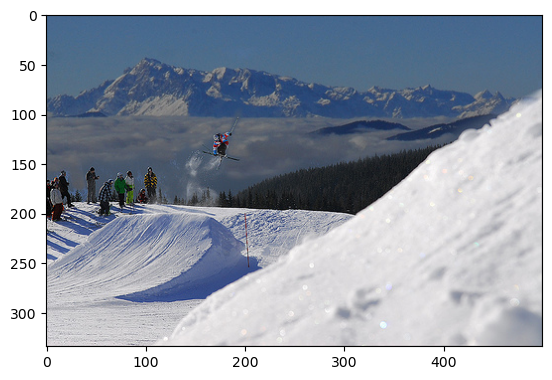

Мера близости: 0.5869
Little kid in blue coat and hat riding a tricycle .


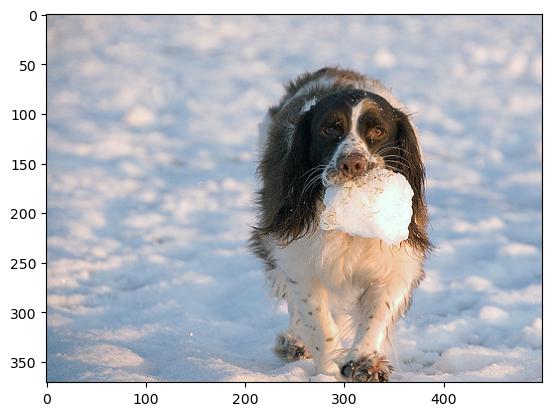

Мера близости: 0.5892
Two black dogs fighting over an orange toy .


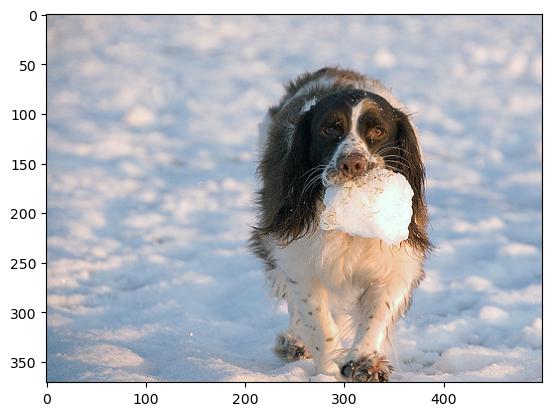

Мера близости: 0.6258
A dog jumping for a tennis ball near an ocean


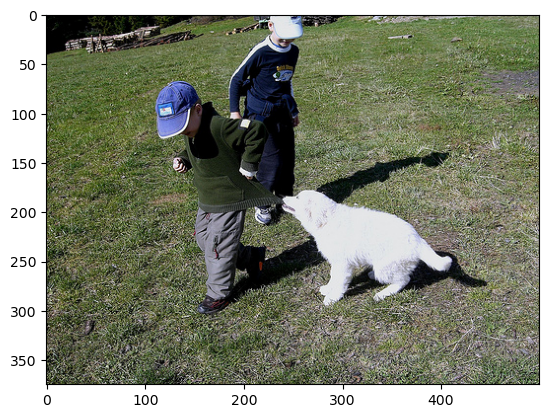

Мера близости: 0.4836
Boy flying a distant kite .


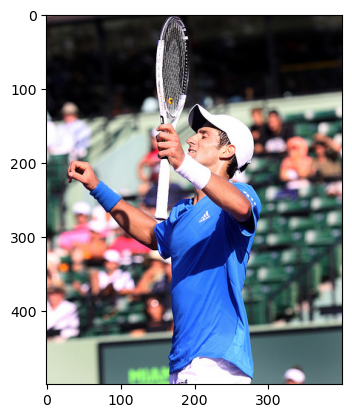

Мера близости: 0.5311
kids play ultimate Frisbee .


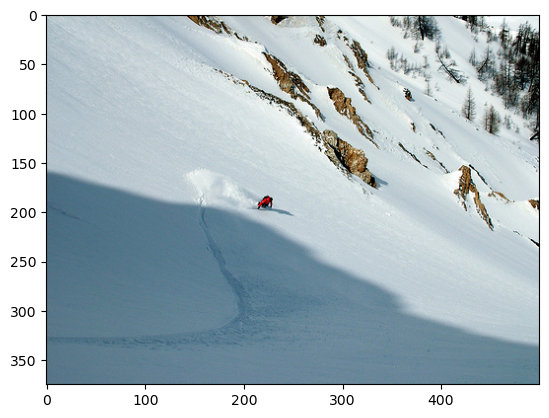

Мера близости: 0.5850
A girl in a purple shirt feeding ducks


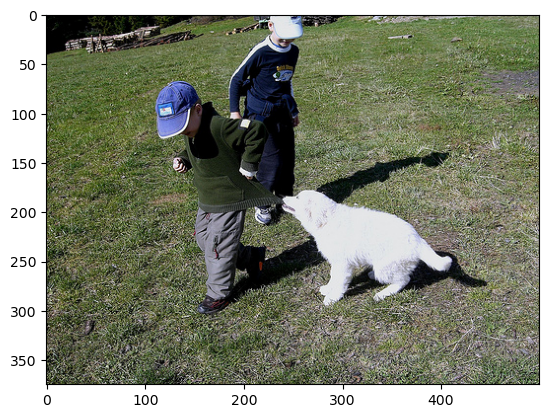

Мера близости: 0.4759
There is a little blond hair girl with a green sweatshirt and a red shirt playing on a playground .


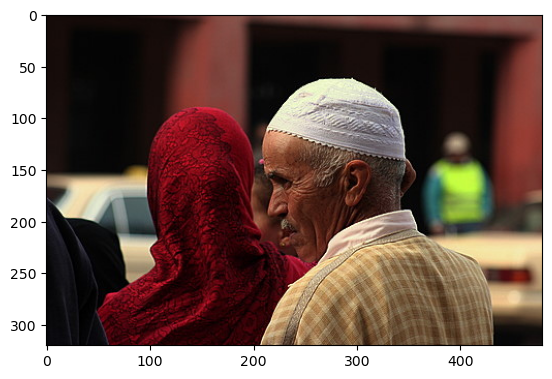

Мера близости: 0.5587
The brown German shepherd dog is playing with a stick .


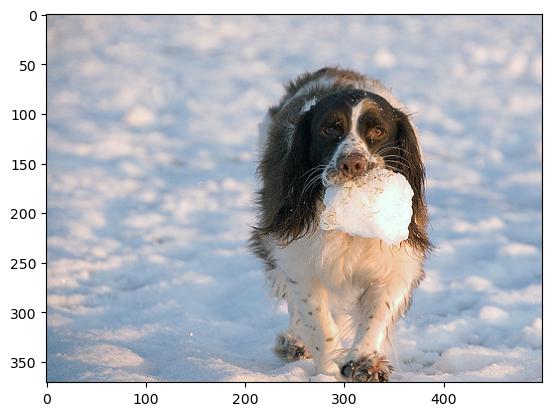

Мера близости: 0.4895
a little girl blows out her candles .


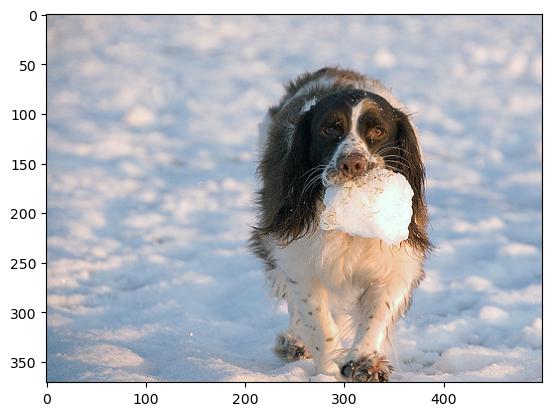

Мера близости: 0.5579
The little boy is smiling as he crosses a rope on an assault course .


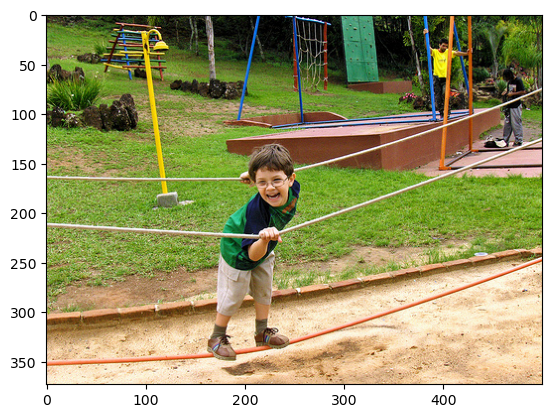

Мера близости: 0.5340
A little white dog in running on the sidewalk .


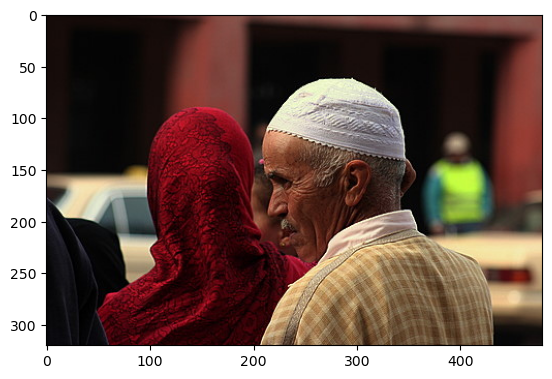

Мера близости: 0.6272
two people sit on a park bench .


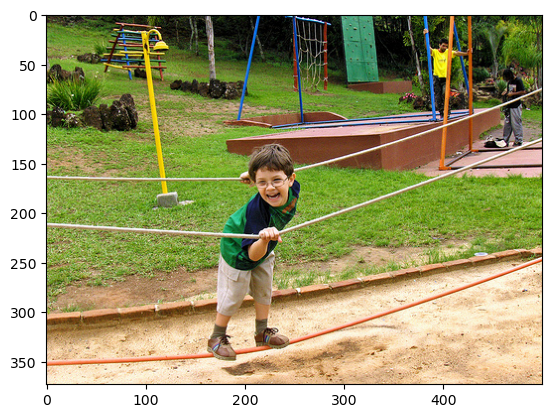

Мера близости: 0.5726
A black dog has a dumbbell in his mouth .


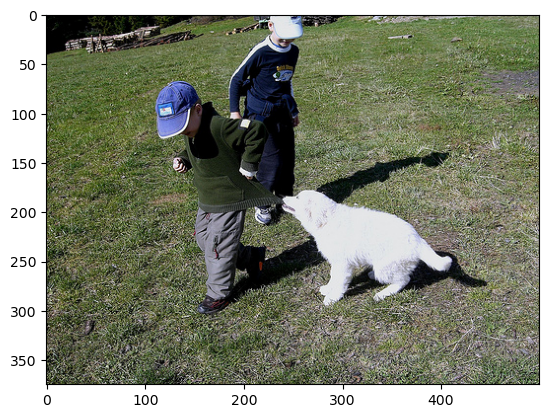

Мера близости: 0.5684
A boy holds a red bucket up to a pony .


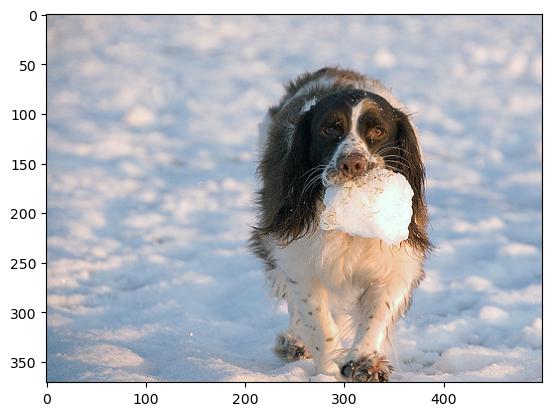

Мера близости: 0.5941
A group of people perform together onstage .


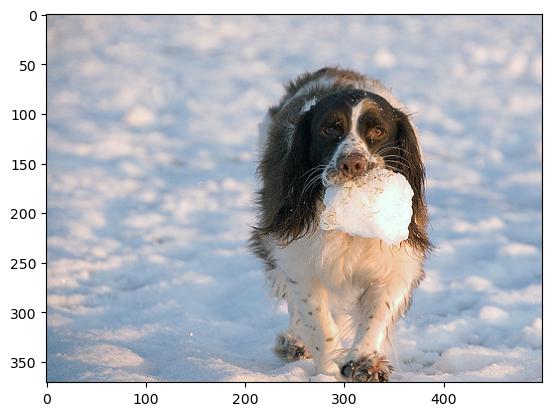

Мера близости: 0.5550
The girl is blowing out the candles on the chocolate cake .


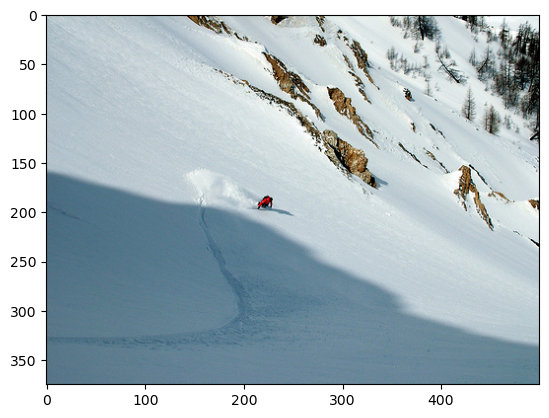

In [1231]:
for i in range(len(tf_idf_test)):
    test_uni = []
    for ii in range(len(output_tensor_test)):
        a_i = tf_idf_test[i]
        b_ii = output_tensor_test[ii]
        a_i_b_ii = np.hstack([a_i, b_ii])
        if len(test_uni) == 0:
            test_uni = a_i_b_ii
        else:
            test_uni = np.vstack([test_uni,a_i_b_ii])

    predictions = cb_model.predict(test_uni)
    best_idx = np.argmax(predictions)
    print('Мера близости:', f'{predictions[best_idx]:.4f}')
    print(preview_df.loc[i,'query_text'])
    plt.imshow(Image.open(r"C:\Users\Igor\Downloads\dsplus_integrated_project_4\to_upload\test_images" + "\\" +test_dataset[best_idx]).convert('RGB'))
    plt.show()

Нужна помощь!
Вроде метрика неплохая, а картинка одна и та же всплывает... что не так делаю?